<a href="https://www.numfys.net"><img class="logo" /></a>

# Discrete Fourier Transform and Fast Fourier Transform

<section class="post-meta">
By Jonas Tjemsland, Andreas Krogen, Håkon Ånes and Jon Andreas Støvneng
</section>
Last edited: Tom Abel Feb 2022
             Tom Abel, 2021: Added painting with circles section, interpolating with FFTs. 
___

This Notebook gives a brief introduction to Discrete Fourier Transform (DFT) and the Fast Fourier Transform (FFT). The radix-2 [Cooley-Tukey FFT](https://en.wikipedia.org/wiki/Cooley–Tukey_FFT_algorithm) algorithm is implemented and toward the end the physical meaning is explained.

These concepts have a wide area of applications in many different areas in both physics and mathematics, such as signal processing, sound and image filtering, data compression, partial differential equations and multiplication of large integers.

We explore one application in which we draw a smooth curve in the plane through a small number of input points by using the DFT to calculate interpolation coefficients. 

We also will introduce  [spectral densities](https://en.wikipedia.org/wiki/Spectral_density) also called power spectrum sometimes. A concept that you will undobtedly run into soon if you have not already as it pops up in an enormous number of fields of study. 

We start by importing the needed packages.

In [1]:
import numpy as np
import matplotlib.pylab as plt
from numpy import random as rnd
import timeit
from scipy import fftpack as fft

## Discrete Fourier Transform (DFT)

Let $\vec x = [x_0,x_1,...,x_{n-1}]$ be a vector with $n$ complex (or real) elements. The DFT of $\vec x$ is the complex vector $\vec y = [y_0,y_1,...,y_{n-1}]$, where the elements are defined as

$$
y_k=\sum_{j=0}^{n-1}x_j\omega^{k\cdot j},
$$

where $\omega = \exp(-2\pi i /n)$ ($i$ is the imaginary unit) [1]. 

In [2]:
def DFT(x):
    """ Calculates the one dimensional discrete Fourier transform of
    a vector.
    
    :x: double arr. The vector that is being transformed.
    :returns: double arr. The Fourier transform of x.
    """
    n = len(x)
    y = [0]*n
    omega = np.exp(-2.0j*np.pi/n)
    for k in range(0,n):
        y[k] = np.sum(x*omega**(np.arange(0,n)*k))
    return y

It is easy to realize that the inverse DFT is given by

$$x_k = \sum_{j=0}^{n-1} y_j\omega^{k\cdot j},$$

where $\omega = \exp(2\pi i/n)$.

In [3]:
def inverseDFT(y):
    """ Calculates the inverse one dimensional discrete Fourier
    transform of a vector.
    
    :y: double arr. The vector that is being transformed.
    :returns: double arr. The inverse Fourier transform of y.
    """
    n = len(y)
    x = [0]*n
    omega = np.exp(2.0j*np.pi/n)
    for k in range(0,n):
        x[k] = np.sum(y*omega**(np.arange(0,n)*k))/float(n)
    return x

Let us try with a small example where we simply transform and inverse transform an arbitrary vector.

In [62]:
# Defining an array that is being transformed.
x = rnd.randint(8,size=8)
print('x =', x)
# The Fourier transform
y = DFT(x)
print('y =', np.round(y,2))
# The inverse Fourier transform. 
x = inverseDFT(y)
print('x =', np.round(x,2))

x = [2 0 0 3 2 1 4 5]
y = [17.  +0.j    0.71+6.12j -0.  +7.j   -0.71-1.88j -1.  -0.j   -0.71+1.88j
  0.  -7.j    0.71-6.12j]
x = [ 2.-0.j  0.-0.j -0.-0.j  3.-0.j  2.-0.j  1.+0.j  4.+0.j  5.+0.j]


As you already might have noticed, this DFT-algorithm is quite inefficient. There are many subcalculations that are performed more than once, and as a consequence the complexity of this algorithm is $\mathcal O(n^2)$. 

## Fast Fourier Transform (FFT)
The FFT algorithms exploits symmetries and that many operations are similar. In this notebook we are going to discuss the Cooley–Tukey algorithm [2].

Assume that $N$ is composite. This means that $N=n_1\cdot n_2$, where $N$, $n_1$ and $n_2$ are integers. Rewrite the two indicies as 

$$
k=n_2k_1+k_2,
$$

$$
j = n_1j_2 + j_1,
$$

where $k_{1,2} = 0,1,...,n_{1,2}-1$ and $j_{1,2} = 0,1,...,n_{1,2}-1$. If we insert these new indicies into the DFT, some cross terms vanish, and the final result is

$$
y_{n_2k_1+k_2}=\sum_{j_1=0}^{n_1-1}\sum_{j_2=0}^{n_2-1}x_{n_1j_2+n_1}\exp\left[\frac{-2\pi i}{n_1n_2}(n_1j_2+j_1)(n_2k_1+k_2)\right]
$$

$$
=\sum_{j_1=0}^{n_1-1}\exp\left[-\frac{2\pi i}{n}j_1k_2\right]\left(\sum_{j_2=0}^{n_2-1}x_{n_1j_2+j_1}\exp\left[-\frac{2\pi i}{n_2}j_2k_2\right]\right)\exp\left[-\frac{2\pi i}{n_1}j_1k_1\right].
$$

In this equation each inner sum is a DFT of size $n_2$ and each outer sum is a DFT of size $n_1$. This yields a recursive formula for computing the DFT, which is explained in more detail in [1] and [4]. For simplicity, let us use the radix-2 algorithm. The complexity of the FFT algorithm is $\mathcal O (n\log n)$, which makes it almost linear for large data sets!

In [5]:
def CooleyTukeyRadix2FFT(x):
    """ Calculates the one dimensional discrete Fourier transform of
    a vector using the radix-2 Cooley-Tukey FFT algorithm. The vector
    that is being transformed must have a power of 2 number of elements.
    
    :x: double arr. The vector that is being transformed.
    :returns: double arr. The Fourier transform of x.
    """
    # Check if n is a power of 2.
    if ( len(x) & (len(x) - 1)):
        raise Exception("The number of elements in x has to be a power of 2!")
    # Recursive formula for calculating the FFT.
    def foo(x):
        n = len(x)
        if n == 1:
            y = x
        else:
            y2 = foo(x[0:n:2])
            y1 = foo(x[1:n + 1:2])
            d = np.exp(-2j*np.pi/n)**np.arange(0,n/2)
            y = np.append(y2 + d*y1,y2 - d*y1)
        return y
    return foo(x)

def inverseCooleyTukeyRadix2FFT(y):
    """ Calculates the one-dimensional inverse discrete Fourier transform of
    a vector using the radix-2 Cooley-Tukey FFT algorithm. The vector
    that is being transformed must have a power of 2 number of elements.
    Parameters:
        x: double arr. The vector that is being transformed.
    Returns:
        y: double arr. The Fourier transform of x.
    """
    # Check if n is a power of 2.
    if (len(y) & (len(y) - 1)):
        raise Exception("The number of elements in x has to be a power of 2!")
    # Recursive formula for calculating the FFT.
    def foo(y):
        n = len(y)
        if n == 1:
            x = y
        else:
            x2 = foo(y[0:n:2])
            x1 = foo(y[1:n + 1:2])
            d = np.exp(2j*np.pi/n)**np.arange(0,n/2)
            x = np.append(x2 + d*x1,x2 - d*x1)
        return x
    return foo(y)/len(y)

Let us try with a small example where we simply transform and inverse transform an arbitrary vector as before.

In [63]:
# Defining the array that is being transformed.
x = rnd.randint(10,size=8)
print('x =', x)
# The Fourier transform.
y = CooleyTukeyRadix2FFT(x)
print('y =', np.round(y,2))
# The invese Fourier transform. 
x = inverseCooleyTukeyRadix2FFT(y)
print('x =', np.round(x,2))

x = [2 5 7 8 4 1 2 4]
y = [33. +0.j   -2.-10.66j -3. +6.j   -2. -0.66j -3. +0.j   -2. +0.66j
 -3. -6.j   -2.+10.66j]
x = [2.+0.j 5.-0.j 7.-0.j 8.+0.j 4.+0.j 1.-0.j 2.+0.j 4.+0.j]


To demonstrate the superiority of the FFT we calculate the Fourier transform of a lot bigger data set. Let us also compare with the fft function from scipy.fftpack.

In [87]:
x = rnd.rand(1024)
# Time the loop time for DFT, CooleyTukeyRadix2FFT, numpy.fft, and scipy.fftpack.fft .
%timeit y = DFT(x)
%timeit y = CooleyTukeyRadix2FFT(x)
%timeit y = np.fft.fft(x)
%timeit y = fft.fft(x) 

64 ms ± 1.14 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)
11 ms ± 88.2 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)
9.26 µs ± 101 ns per loop (mean ± std. dev. of 7 runs, 100,000 loops each)
7.78 µs ± 121 ns per loop (mean ± std. dev. of 7 runs, 100,000 loops each)


## Physical meaning

The DFT maps a finite equally spaced sample sequence from its original domain to its frequency domain. In other words, a discrete time data set are transformed into a discrete frequency data set.

To illustrate this, we need to figure out what the DFT-formula physically means. We start by rewriting it as

$$
x_k=\sum_{j=0}^{n-1}y_j\exp\left(2\pi i\frac{k}{n\Delta t}j\Delta t\right).
$$

What the expression tells us is simply that $\vec x$ is a superposition of exponential functions with different frequencies $f_j = \frac{j}{n\Delta t}$ and amplitudes $y_j$. Therefore, we can view the magnitude of the amplitudes $|y_k|^2$ as a measure of the "weight of the frequency $f_j$" in $\vec x$!

Do remember that the complex exponential functions relate to cosines and sines through [Euler's formula](https://en.wikipedia.org/wiki/Euler%27s_formula)

$$
e{^{i\, x}} = \cos(x) + i\sin(x)
$$

## Multidimensional DFT
Let $\vec{j} = (j_1,j_2,...,j_d)$ and $\vec{k} = (k_1,k_2,...,k_d)$ be $d$-dimensional vectors of indicies from $ 0$ to $n-1 = (n_1-1,n_2,...,n_d-1)$. Then, the $d$-dimensional DFT is given by

$$
y_{\vec{k}}=\sum_{\vec{j}=0}^{n-1}x_{\vec{j}}\exp\left[-2\pi\vec{k}\cdot\vec{\xi}\right],
$$

where $\vec{\xi}$ is the elementwise division $(j_1/n_1,...,j_d/n_d)$ [4]. For example, the two dimensional DFT is given by

$$
\vec {y_{k_1,k_2}}=\sum_{j_1=0}^{n_1-1}\sum_{j_2=0}^{n_2-1}x_{j_1,j_2}\exp\left[-2\pi i\left(\frac{ k_1j_1}{n_1}+\frac{k_2j_2}{n_2}\right)\right].
$$

## Interpolation using FFTs: Drawing with circles

This is a very fun activity and made popular by this really neat 
[youtube video](https://youtu.be/r6sGWTCMz2k) among others by [3Blue1Brown](https://www.youtube.com/channel/UCYO_jab_esuFRV4b17AJtAw). Someone on [stackexchange](https://dsp.stackexchange.com/questions/59068/how-to-get-fourier-coefficients-to-draw-any-shape-using-dft) was working through it and drew a nice version of $\pi$ 
<p>
<BR CLEAR=”left” />
<img src="https://i.stack.imgur.com/V2piv.jpg" ALIGN=”right” width=300 />
and stored a set of 120 x and y positions along the symbol in a handy comma separated file, which I turned into a list to include here. 
</p>


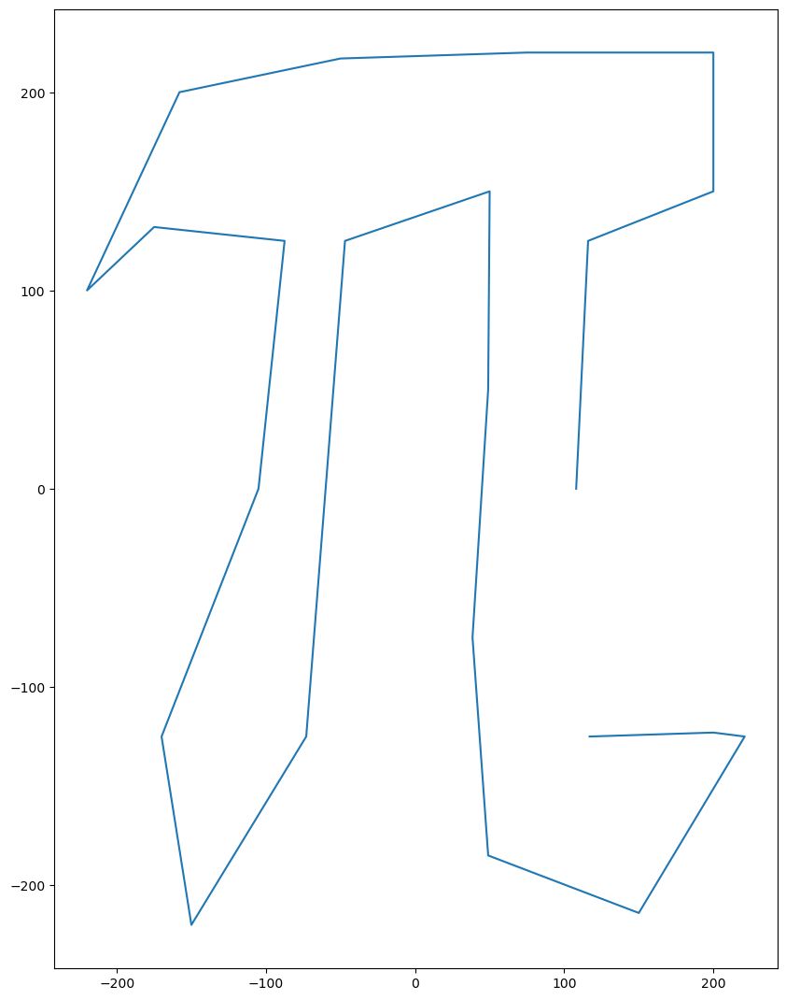

In [68]:
xy = [108,0,110,25,112,50,113.5,75,115,100,116,125,117.5,150,125,150,150,150,175,150,200,150,225,150,225,175,225,200,225,220,200,220,175,220,150,220,125,220,100,220,75,220,50,220,25,220,0,219.5,-25,219,-50,217,-75,215,-100,212,-125,209,-150,203,-158,200,-175,190,-190,175,-203,150,-211,125,-220,100,-225,85,-209,85,-200,100,-182,125,-175,132,-150,145,-125,150,-100,150,-87,150,-87.5,125,-89,100,-92,75,-95,50,-100,25,-105,0,-113,-25,-122,-50,-136,-75,-152,-100,-170,-125,-186,-150,-189,-175,-178,-200,-175,-205,-150,-220,-125,-220,-100,-202,-85,-175,-77,-150,-73,-125,-70,-100,-67.5,-75,-65,-50,-62,-25,-60,0,-57,25,-54.5,50,-51.5,75,-49,100,-47,125,-45,150,-25,150,0,150,25,150,50,150,58,150,55,125,53,100,51,75,49,50,47,25,44.5,0,42,-25,40,-50,38.5,-75,37.5,-100,37,-125,37.5,-150,43,-175,49,-185,66,-200,75,-205,100,-215,125,-218,150,-214,175,-203,179,-200,201.5,-175,213,-150,221,-125,226.5,-100,227.5,-88,210,-88,209,-100,200,-123,197,-125,175,-141,150,-144,125,-134,117,-125,109,-100,106,-75,106,-50,106.5,-25]
x = np.array(xy[::10]) # select only a subset of the values
y = np.array(xy[1::10])
N = len(x)
plt.plot(x,y);

So we have a parametric curve where a vectors x and y coordinate are given along the line parameterized by an extra parameter $t$, specifying $x(t)$ and $y(t)$. 

In [71]:
from scipy.interpolate import interp1d
t = np.arange(N)/(N-1)
xt = interp1d(t, x, bounds_error=False)
yt = interp1d(t, y, bounds_error=False)
xtc = interp1d(t, x, kind="cubic", bounds_error=False)
ytc = interp1d(t, y, kind="cubic", bounds_error=False)

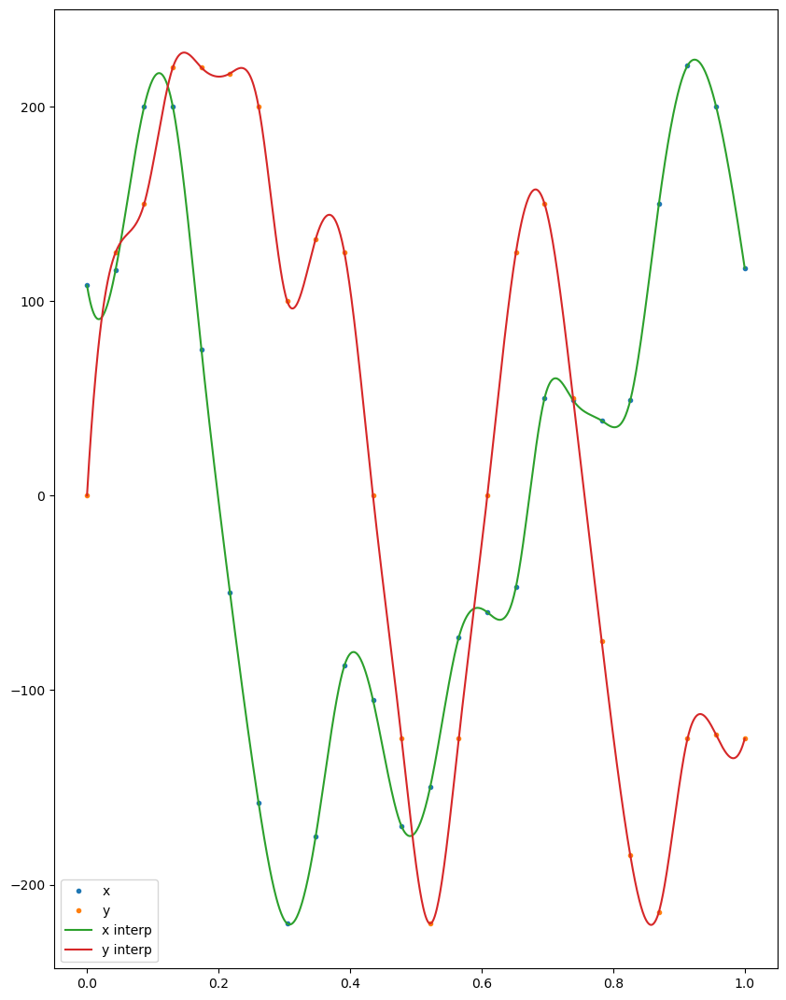

In [74]:
tf = np.linspace(0,1,1200) # finer representation of t
plt.plot(t, x,'.', label="x")
plt.plot(t, y,'.', label="y")

plt.plot(tf, xtc(tf), label="x interp")
plt.plot(tf, ytc(tf), label="y interp");
plt.legend();


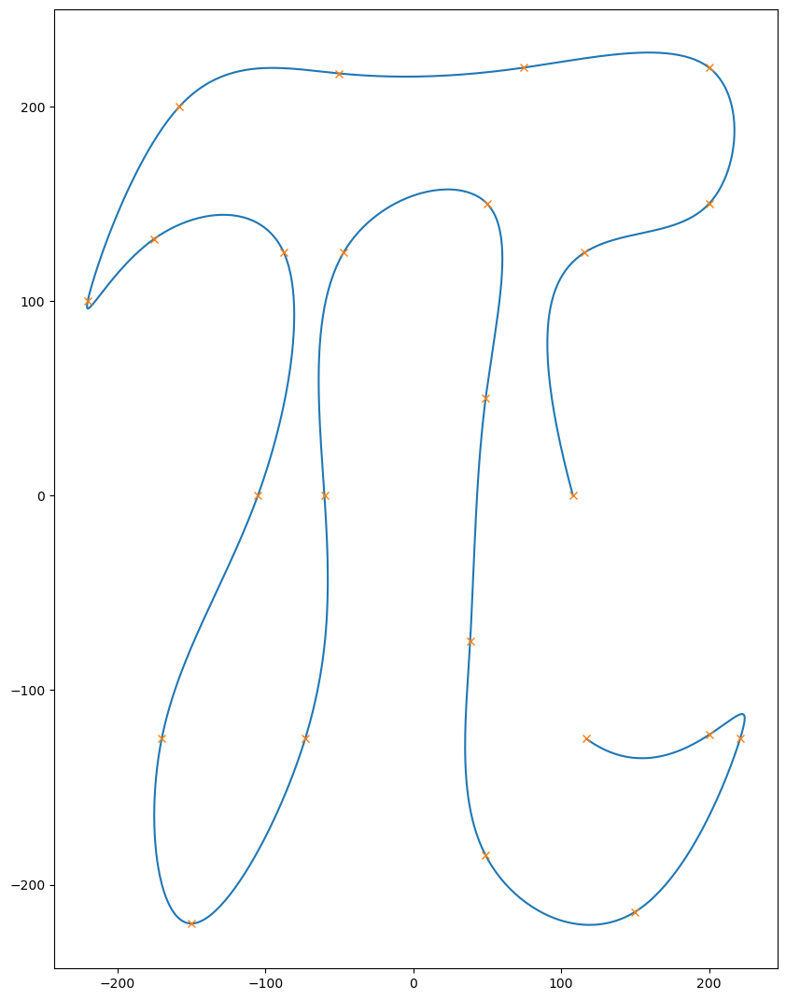

In [76]:
plt.plot(xtc(tf), ytc(tf))
plt.plot(x,y,"x")

We can interpret every point as a location in the complex plane so that any of our input $(x_j,y_j)$ points can be expressed as a complex number $z_j = x_j + i y_j$. The inverse Fourier transform of these complex numbers will describe properties of cyclic functions which when all added together will give back the input values. 
So we can get using our discrete Fourier transform the values

$$
Z_k = \sum_{n=0}^{N-1} z_j e^{-i jk\frac{2\pi}{N}}
$$

and can get back the values $z[j]$ if we have $Z[k]$ with the inverse of that transform

$$
z_j = \frac{1}{N}\sum_{k=0}^{N-1} Z_k e^{i jk\frac{2\pi}{N}}
$$

For the discrete Fourier transform most implementations consider though the form in which both positive and negative frequencies are considered:

$$
Z_k = \sum_{k=-N/2+1}^{N/2} z_j e^{-i jk\frac{2\pi}{N}}
$$

and can get back the values $z[j]$ if we have $Z[k]$ with the inverse of that transform

$$
z_j = \frac{1}{N}\sum_{k=-N/2+1}^{N/2} Z_k e^{i jk\frac{2\pi}{N}}
$$

Now if we think of our distinct positions $j$ as part of a continuous field $j \equiv t N$ then we can represent 

$$
z(t) = \frac{1}{N}\sum_{k=-N/2+1}^{N/2} Z_k e^{i 2\pi k t} 
$$

which will match $z_j$ when $t=j/N$. This is the key idea behind Fourier interpolation. 
Below we will use $z_k\equiv Z_k/N$ so that $z(t)=\sum z_k e^{i 2\pi k t} $. 

In [77]:
z = x[:] + 1j * y[:] # express our points on the curve as complex numbers
N = len(z)
Zk = np.fft.fft(z)  # calculate Fourier coefficients
zk = Zk/N           # absorb the 1/N factor into the Zk to 
k = np.fft.fftfreq(N, d=1/N); # use helper function to tell us where which frequencies are

In [79]:
np.fft.fftshift(k)

array([-12., -11., -10.,  -9.,  -8.,  -7.,  -6.,  -5.,  -4.,  -3.,  -2.,
        -1.,   0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,
        10.,  11.])

In [19]:
amp = np.abs(zk)
phase = np.angle(zk)

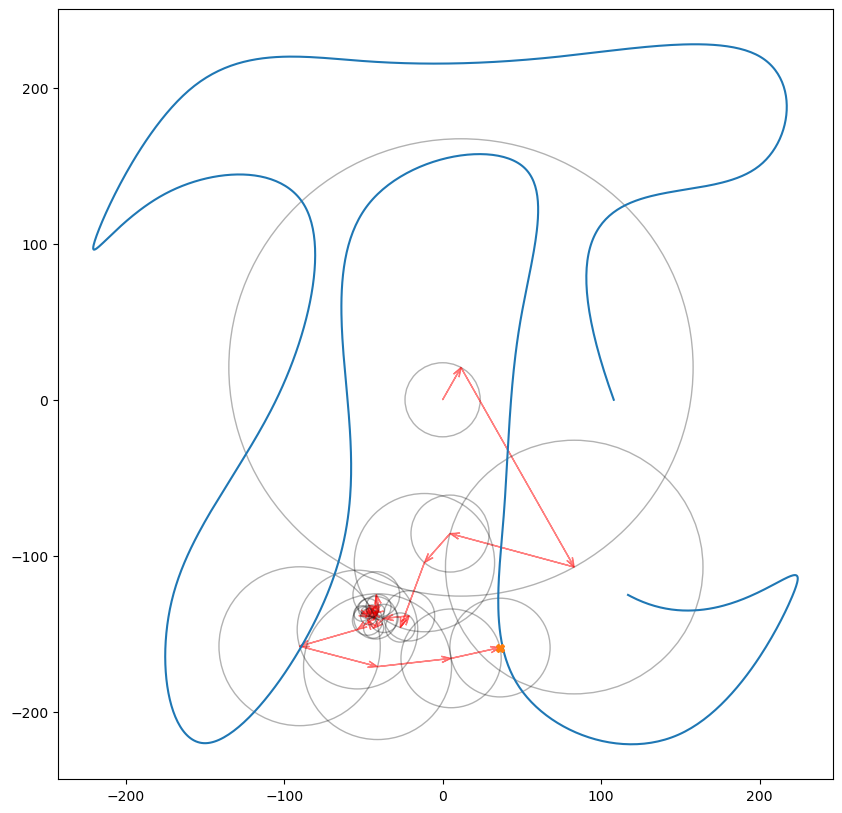

In [80]:
tp = 0.78
testp = np.sum(zk*np.exp(1j*k*2*np.pi * tp)) 
fig = plt.figure(figsize=(10,10))
ax = plt.gca()
ax.cla() # clear things for fresh plot
#ax.plot(xt(tf),yt(tf))
ax.plot(xtc(tf),ytc(tf))
ax.plot([np.real(testp)], [np.imag(testp)],'X')
xp = 0
yp = 0
xl = []
yl = []
for i in range(N):
    xl.append(xp)
    yl.append(yp)
#    print(k[i],amp[i],phase[i], xp, yp)
#    xp = xp + amp[i]*np.cos(2.*np.pi*k[i]*tp + phase[i] )
#    yp = yp + amp[i]*np.sin(2.*np.pi*k[i]*tp + phase[i] )
    zc = zk[i]*np.exp(1j*k[i]*2*np.pi * tp)  # this is the same as above 
    circ = plt.Circle((xp, yp), amp[i], color='black', fill=False, alpha=.3)
    plt.arrow(xp,yp,zc.real,zc.imag,overhang=.8,color="red",\
        head_width=4,length_includes_head=True,alpha=.5)
    xp = xp + zc.real
    yp = yp + zc.imag
    ax.add_patch(circ)
circ = plt.Circle((xp, yp), amp[i], color='black', fill=False, alpha=.3)
ax.add_patch(circ)
xl.append(xp)
yl.append(yp)
#ax.plot(xl,yl, color="red",alpha=.3);

Let's try and also do an animation of a similar plot. 

In [83]:
from matplotlib import animation
from IPython.display import HTML

def Circles2DMovie(ik,izk):
    Nt = 120 # frames
    print("Nt:",Nt)

    amp = np.abs(izk)
    phase = np.angle(izk)

    k = ik
    zk = izk

    xyt = np.zeros((Nt,2))
    for i in range(Nt):
        zc = (zk * np.exp(1j*k*2*np.pi * i/Nt)).sum()
        xyt[i,0] = zc.real
        xyt[i,1] = zc.imag

    # create a simple animation
    fig = plt.figure(figsize=(10,10))

    ax = plt.axes(xlim=(-250, 250), ylim=(-250, 250))
    line, = ax.plot([], [], 'o',lw=5)
    uline, = ax.plot([], [], '-',lw=3.3,alpha=.4)
    qax  = ax.quiver(zk.real,zk.imag,zk.real,zk.imag,alpha=.3)

    ax.set_xlabel('x')
    ax.set_ylabel('y')
    plt.close() # this makes sure the empty initial plot is not shown separately

    def init():
        line.set_data([], [])
        return line, #line2,
    
    def animate(i):
#        ax.clear()
        zp = (zk*np.exp(1j*k*2*np.pi * i/Nt))
        zc = zp.cumsum()
        zo =  np.roll(zp.cumsum(),1)
        zo[0] = 0+0j
        qax.set_offsets(np.c_[zo.real,zo.imag])
        qax.set_UVC(zp.real,zp.imag)

# would be nice to animate the circles [but need to figure out how to update them ..]
#        for ii,czp in enumerate(zc):
#            ax.add_artist(plt.Circle((czp.real,czp.imag), radius=np.abs(zp[ii]), color='black', alpha=0.3, fill=False))
 
        line.set_data(zc[-1].real,zc[-1].imag)
        uline.set_data(xyt[0:i,0],xyt[0:i,1])

        return line, uline, #line2,
    
    return animation.FuncAnimation(fig, animate, init_func=init,
                            frames=Nt, interval=60, blit=True, repeat=True)

mov = Circles2DMovie(k,zk)
HTML(mov.to_jshtml())

Nt: 120


/var/folders/8h/csrqy1dd1x1d93qvzyh33kn40000gn/T/ipykernel_45710/57841117.py:49: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  line.set_data(zc[-1].real,zc[-1].imag)


In [85]:

hz = ( zk  ) 
s = np.argsort(np.abs(hz))[::-1]

mov = Circles2DMovie(k[s],zk[s])
HTML(mov.to_jshtml())

Nt: 120


/var/folders/8h/csrqy1dd1x1d93qvzyh33kn40000gn/T/ipykernel_45710/57841117.py:49: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  line.set_data(zc[-1].real,zc[-1].imag)


In [86]:
np.fft.fftshift(np.arange(len(k)))

array([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,  0,  1,  2,  3,  4,
        5,  6,  7,  8,  9, 10, 11])

In [81]:

s = np.fft.fftshift(np.arange(len(k)))

mov = Circles2DMovie(k[s],zk[s])
HTML(mov.to_jshtml())

Nt: 240


/var/folders/8h/csrqy1dd1x1d93qvzyh33kn40000gn/T/ipykernel_45710/1637310528.py:49: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  line.set_data(zc[-1].real,zc[-1].imag)


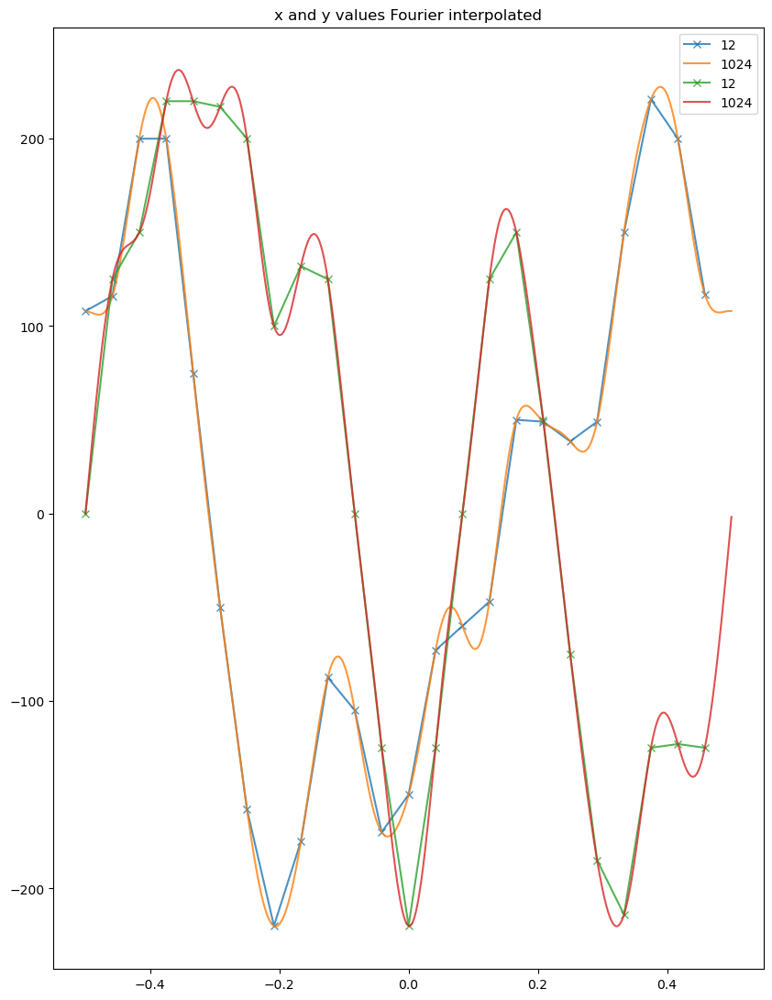

In [55]:
N21 = int(N/2)
nN = 2048
nN2 = 1024 # half of nN
zn = np.zeros(nN,dtype=np.complex64) # set all but the original frequencies to 0
zn[0:N21] = zk[0:N21]
zn[-(N21):] = zk[-(N21):]
znd = np.fft.ifft(zn)*nN             # Fourier transform back to where z and y originally came from
knd = np.fft.fftfreq(nN,d=1/nN)      # new frequencies
plt.plot(np.roll(k,N21)/N, z.real, 'x-', alpha=.8,label=str(N21))
plt.plot(np.roll(knd,nN2)/nN, znd.real, alpha=.8,label=str(nN2))
plt.plot(np.roll(k,N21)/N, z.imag, 'x-', alpha=.8,label=str(N21))
plt.plot(np.roll(knd,nN2)/nN, znd.imag, alpha=.8,label=str(nN2))
plt.legend();
plt.title("x and y values Fourier interpolated");

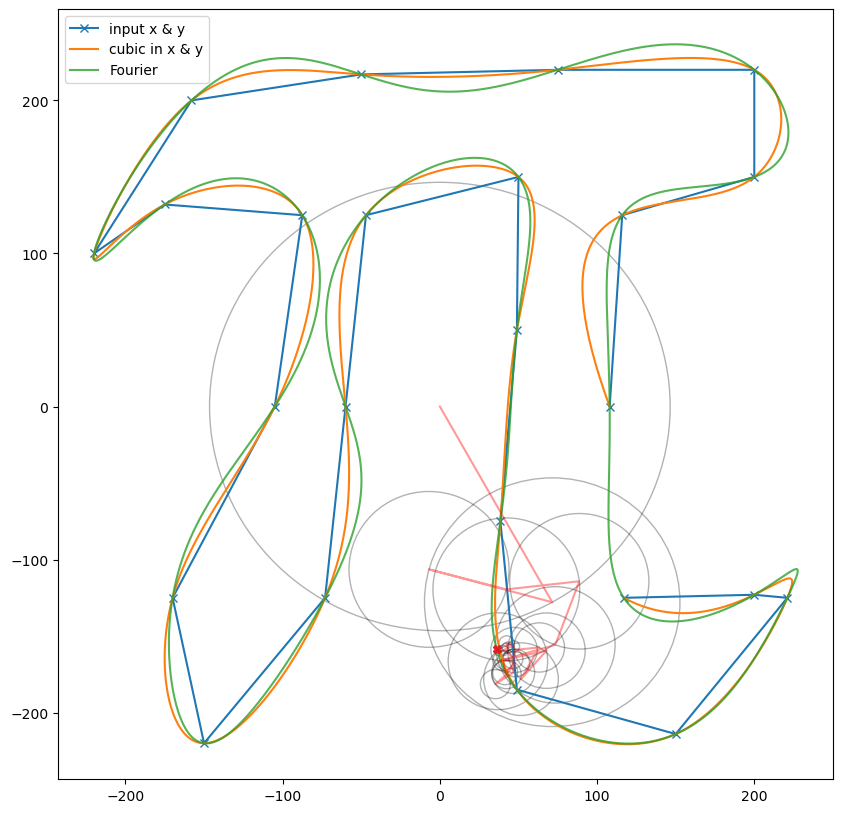

In [23]:
# Same as above just changing the order at which the frequencies are drawn
# We should make an animation of this
tp = 0.78
testp = np.sum(zk*np.exp(1j*k*2*np.pi * tp))
# sort it by descending amplitude so we draw the large circles first
s = amp.argsort()[::-1]
fig = plt.figure(figsize=(10,10))
ax = plt.gca()
ax.cla() # clear things for fresh plot
ax.plot(x,y,'x-', label="input x & y")
ax.plot(xtc(tf),ytc(tf), label="cubic in x & y")
plt.plot(znd.real, znd.imag, alpha=.8, label="Fourier")
ax.plot([np.real(testp)], [np.imag(testp)],'X')
xp = 0
yp = 0
xl = [xp]
yl = [yp]
for i in s:
    circ = plt.Circle((xp, yp), amp[i], color='black', fill=False, alpha=.3)
    ax.add_patch(circ)
#    print(k[i],amp[i],phase[i], xp, yp)
    xp = xp + amp[i]*np.cos(2.*np.pi*k[i]*tp + phase[i] )
    yp = yp + amp[i]*np.sin(2.*np.pi*k[i]*tp + phase[i] )
#    zc = zi[i]*np.exp(1j*k[i]*2*np.pi * tp)
#    xp = xp + zc.real
#    yp = yp + zc.imag
    xl.append(xp)
    yl.append(yp)
ax.plot(xl,yl, color="red", alpha=.4)
plt.legend();

If we now pretend we have a much finer grid in $k$-space but all the frequencies but the ones we just calculated are zero, we can Fourier transform back to position space and and get values for x and y on a very fine grid.

In [24]:
k

array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
        11., -12., -11., -10.,  -9.,  -8.,  -7.,  -6.,  -5.,  -4.,  -3.,
        -2.,  -1.])

Another way we think of the Fourier representation that it takes a function and represents it as a some of plane waves $\sum ze^{2\pi kx}$.

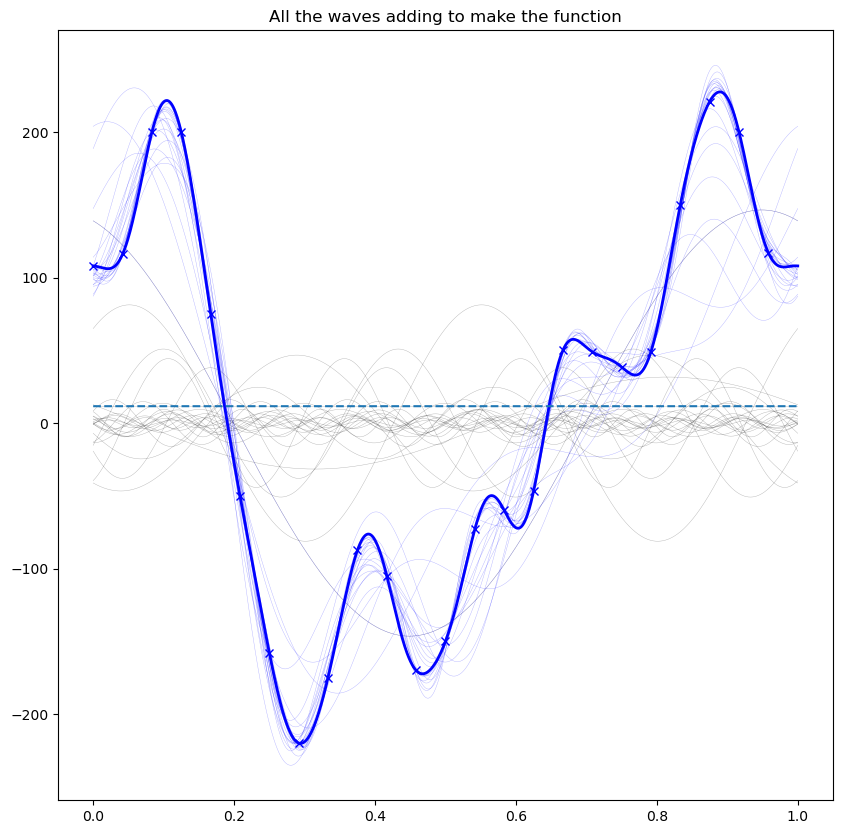

In [25]:
fig = plt.figure(figsize=(10,10))
psu = np.zeros(len(tf), dtype=np.complex64)
s = amp.argsort()[::-1]

for i in s[:]:
    cwx = amp[i]*np.cos(2.*np.pi*k[i]*tf + phase[i])
    psu = psu + zk[i]*np.exp(1j*k[i]*2*np.pi * tf)
    plt.plot(tf, cwx, c='black', alpha=.3, lw=.3 )
    plt.plot(tf, np.real(psu), c='b', alpha=.3, lw=.3 )

plt.plot(t,x,'bx')
plt.plot(tf,np.real(psu), 'b', lw=2)
plt.plot(tf,np.real(zk[0]*np.exp(1j*k[0]*2*np.pi * tf)),'--') # zero mode gives average
plt.title("All the waves adding to make the function");

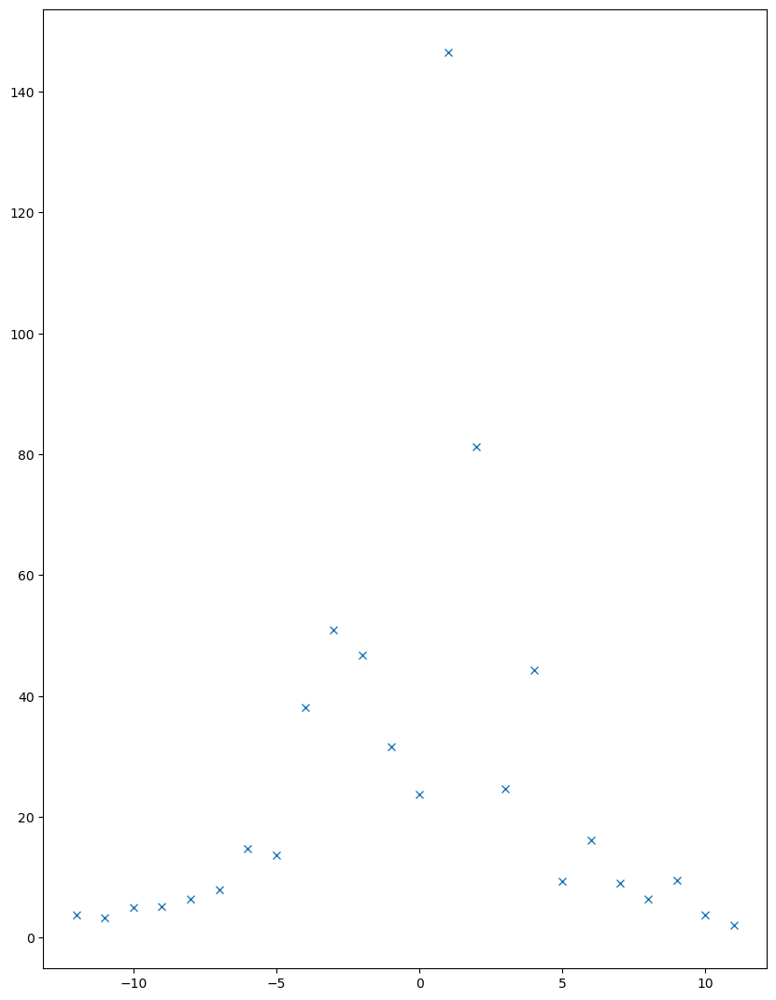

In [26]:
sind = np.roll(np.arange(N), N21) # shifting the arrays to have the frequencies ordered in ascending
plt.plot(k[sind],amp[sind],'x');

References:  
[1] T. Sauer: Numerical Analysis, second edition, Pearson 2014  
[2] James W. Cooley and John W. Tukey: An Algorithm for the Machine Calculation of Complex Fourier Series, Math. Comp. 19 (1965), p. 297-301  
[3] Wikipedia: https://en.wikipedia.org/wiki/Cooley%E2%80%93Tukey_FFT_algorithm, 03.28.2016 (acquired: April 2016)  
[4] Wikipedia: https://en.wikipedia.org/wiki/Discrete_Fourier_transform, 04.28.2016 (acquired: April 2016)

Check out the FFT pack in SciPy:
http://docs.scipy.org/doc/scipy/reference/fftpack.html  

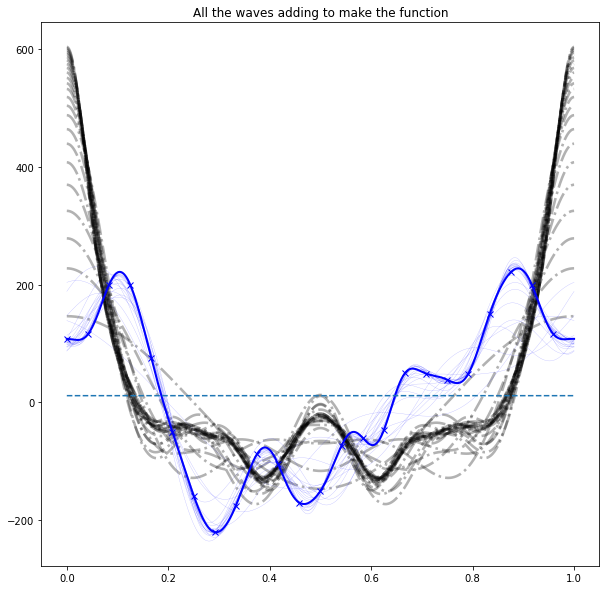

In [ ]:
fig = plt.figure(figsize=(10,10))
psu = np.zeros(len(tf), dtype=np.complex64)
s = amp.argsort()[::-1]
cwx = np.zeros(len(tf))

for i in s[:]:
#    cwx = cwx + amp[i]*np.cos(2.*np.pi*k[i]*tf + phase[i])
    cwx = cwx + amp[i]*np.cos(2.*np.pi*k[i]*tf )

    psu = psu + zk[i]*np.exp(1j*k[i]*2*np.pi * tf)
    plt.plot(tf, cwx,'-.', c='black', alpha=.3, lw=2.6 )
    plt.plot(tf, np.real(psu), c='b', alpha=.3, lw=.3 )

plt.plot(t,x,'bx')
plt.plot(tf,np.real(psu), 'b', lw=2)
plt.plot(tf,np.real(zk[0]*np.exp(1j*k[0]*2*np.pi * tf)),'--') # zero mode gives average
plt.title("All the waves adding to make the function");